In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import IPython.display as ipyd
from libs import gif, nb_utils

In [2]:
# Bit of formatting because I don't like the default inline code style:
from IPython.core.display import HTML
HTML("""<style> .rendered_html code { 
    padding: 2px 4px;
    color: #c7254e;
    background-color: #f9f2f4;
    border-radius: 4px;
} </style>""")

In [3]:
sess = tf.InteractiveSession()

In [4]:
from libs import inception
net = inception.get_inception_model()

In [5]:
nb_utils.show_graph(net['graph_def'])

In [6]:
tf.import_graph_def(net['graph_def'], name='inception')

In [7]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

In [8]:
g = tf.get_default_graph()
names = [op.name for op in g.get_operations()]
print(names)

['inception/input', 'inception/conv2d0_w', 'inception/conv2d0_b', 'inception/conv2d1_w', 'inception/conv2d1_b', 'inception/conv2d2_w', 'inception/conv2d2_b', 'inception/mixed3a_1x1_w', 'inception/mixed3a_1x1_b', 'inception/mixed3a_3x3_bottleneck_w', 'inception/mixed3a_3x3_bottleneck_b', 'inception/mixed3a_3x3_w', 'inception/mixed3a_3x3_b', 'inception/mixed3a_5x5_bottleneck_w', 'inception/mixed3a_5x5_bottleneck_b', 'inception/mixed3a_5x5_w', 'inception/mixed3a_5x5_b', 'inception/mixed3a_pool_reduce_w', 'inception/mixed3a_pool_reduce_b', 'inception/mixed3b_1x1_w', 'inception/mixed3b_1x1_b', 'inception/mixed3b_3x3_bottleneck_w', 'inception/mixed3b_3x3_bottleneck_b', 'inception/mixed3b_3x3_w', 'inception/mixed3b_3x3_b', 'inception/mixed3b_5x5_bottleneck_w', 'inception/mixed3b_5x5_bottleneck_b', 'inception/mixed3b_5x5_w', 'inception/mixed3b_5x5_b', 'inception/mixed3b_pool_reduce_w', 'inception/mixed3b_pool_reduce_b', 'inception/mixed4a_1x1_w', 'inception/mixed4a_1x1_b', 'inception/mixed4a_3

In [9]:
input_name = names[0] + ":0"
x = g.get_tensor_by_name(input_name)

In [10]:
input_name

'inception/input:0'

In [11]:
names[-1] + ':0'

'inception/output2:0'

In [12]:
softmax = g.get_tensor_by_name(names[-1] + ':0')

In [13]:
softmax.get_shape()

TensorShape([Dimension(None), Dimension(1008)])

0 255


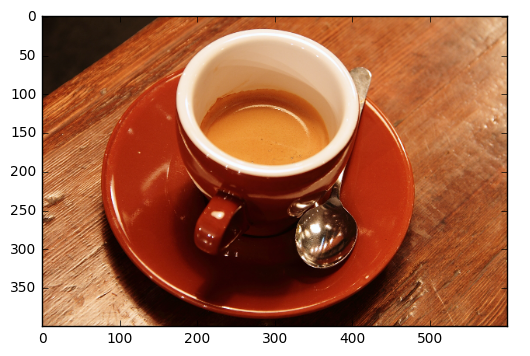

In [14]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)
print(og.min(), og.max())

In [15]:
img = inception.preprocess(og)

In [16]:
print(og.shape),print(img.shape)

(400, 600, 3)
(299, 299, 3)


(None, None)

In [17]:
print(img.min(), img.max())

-117.0 138.0


In [18]:
img_4d = img[np.newaxis]
print(img_4d.shape)

(1, 299, 299, 3)


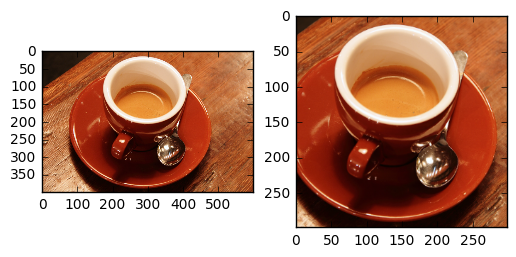

In [19]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(og)
axs[1].imshow(inception.deprocess(img))

In [20]:
img_4d.shape

(1, 299, 299, 3)

In [21]:
img_4d_2 = np.concatenate((img_4d, img_4d), axis=0)

In [22]:
res = softmax.eval(feed_dict={x: img_4d})

In [23]:
res.shape

(16, 1008)

In [24]:
np.squeeze(res)

array([[  1.08247465e-14,   1.91724319e-17,   1.59638166e-12, ...,
          1.08240460e-14,   1.08253259e-14,   1.08247888e-14],
       [  1.43945848e-15,   1.36372873e-18,   2.80957739e-13, ...,
          1.43935970e-15,   1.43953535e-15,   1.43946399e-15],
       [  2.74944269e-15,   2.86159328e-18,   4.06765848e-13, ...,
          2.74925401e-15,   2.74958944e-15,   2.74945328e-15],
       ..., 
       [  1.24471602e-14,   3.66610186e-17,   5.05053161e-12, ...,
          1.24463055e-14,   1.24477768e-14,   1.24471602e-14],
       [  2.28704317e-14,   7.87223620e-17,   7.89168036e-12, ...,
          2.28688613e-14,   2.28716091e-14,   2.28704757e-14],
       [  3.93821558e-13,   2.98510462e-15,   6.53753926e-11, ...,
          3.93794535e-13,   3.93841860e-13,   3.93822317e-13]], dtype=float32)

In [25]:
res.shape

(16, 1008)

In [26]:
res

array([[  1.08247465e-14,   1.91724319e-17,   1.59638166e-12, ...,
          1.08240460e-14,   1.08253259e-14,   1.08247888e-14],
       [  1.43945848e-15,   1.36372873e-18,   2.80957739e-13, ...,
          1.43935970e-15,   1.43953535e-15,   1.43946399e-15],
       [  2.74944269e-15,   2.86159328e-18,   4.06765848e-13, ...,
          2.74925401e-15,   2.74958944e-15,   2.74945328e-15],
       ..., 
       [  1.24471602e-14,   3.66610186e-17,   5.05053161e-12, ...,
          1.24463055e-14,   1.24477768e-14,   1.24471602e-14],
       [  2.28704317e-14,   7.87223620e-17,   7.89168036e-12, ...,
          2.28688613e-14,   2.28716091e-14,   2.28704757e-14],
       [  3.93821558e-13,   2.98510462e-15,   6.53753926e-11, ...,
          3.93794535e-13,   3.93841860e-13,   3.93822317e-13]], dtype=float32)

In [27]:
res = np.mean(res, 0)
res = res / np.sum(res)

In [28]:
res

array([  3.95740501e-14,   2.34581566e-16,   7.38100640e-12, ...,
         3.95713363e-14,   3.95760898e-14,   3.95741247e-14], dtype=float32)

In [29]:
print([(res[idx],net['labels'][idx]) for idx in res.argsort()[-5:][::-1]])

[(0.99849206, (947, 'espresso')), (0.000631253, (859, 'cup')), (0.00050241494, (953, 'chocolate sauce')), (0.00019483209, (844, 'consomme')), (0.00013370356, (822, 'soup bowl'))]


# Visualize Filters

In [30]:
W = g.get_tensor_by_name('inception/conv2d0_w:0')
W_eval = W.eval()
print(W_eval.shape)

(7, 7, 3, 64)


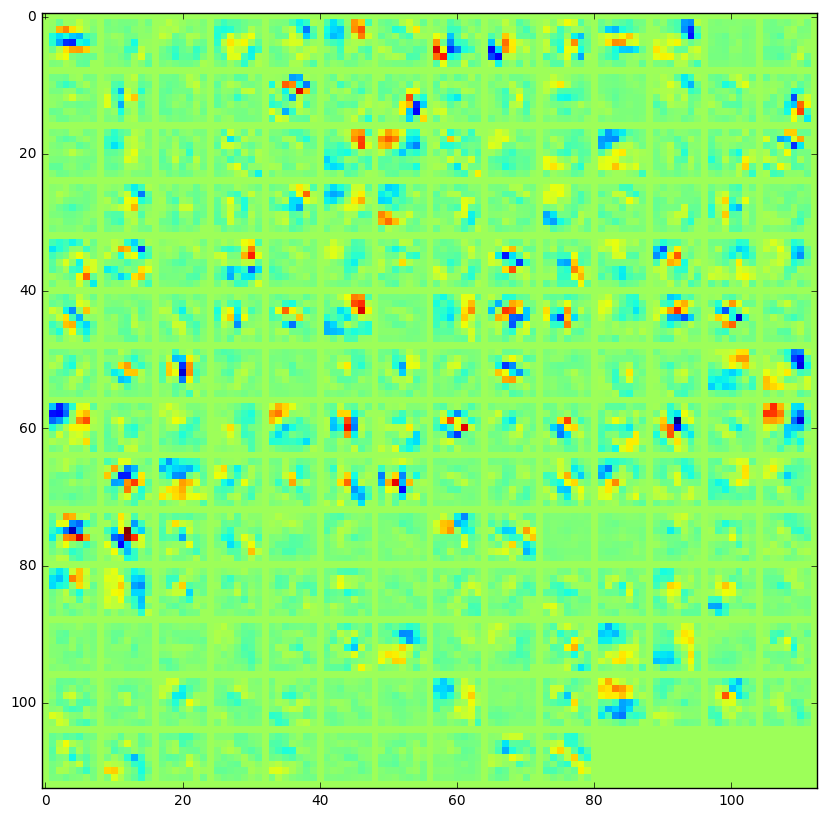

In [31]:
from libs import utils
W_montage = utils.montage_filters(W_eval)
plt.figure(figsize=(10,10))
plt.imshow(W_montage, interpolation='nearest')

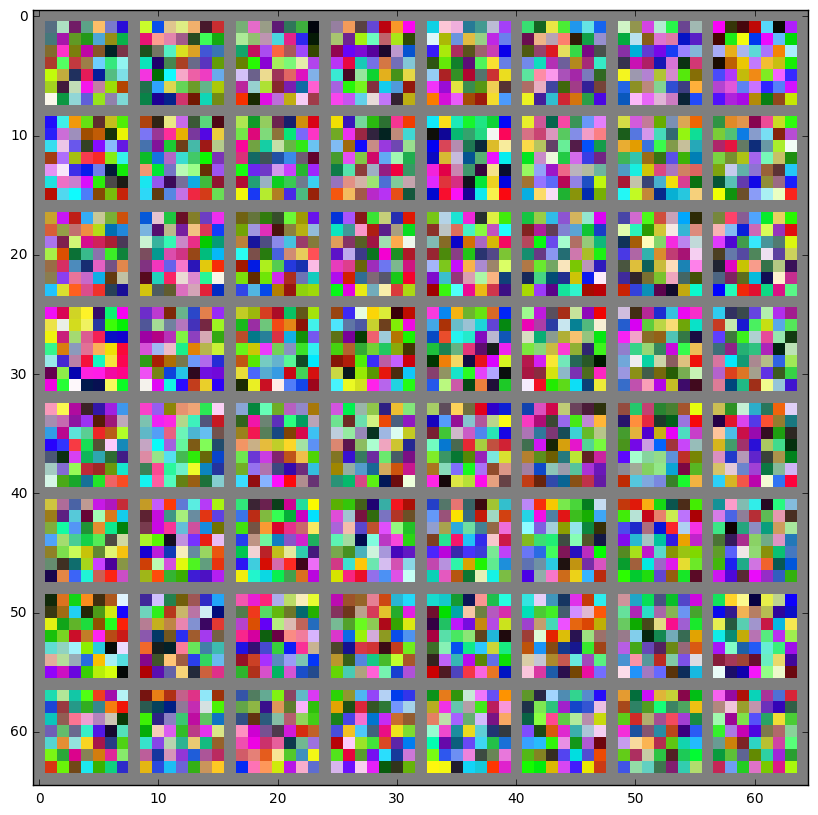

In [32]:
Ws = [utils.montage_filters(W_eval[:,:,[i],:]) for i in range(3)]
Ws = np.rollaxis(np.array(Ws), 0, 3)
plt.figure(figsize=(10, 10))
plt.imshow(Ws, interpolation='nearest')

In [33]:
np.min(Ws), np.max(Ws)

(-6.4092006683349609, 6.3349862098693848)

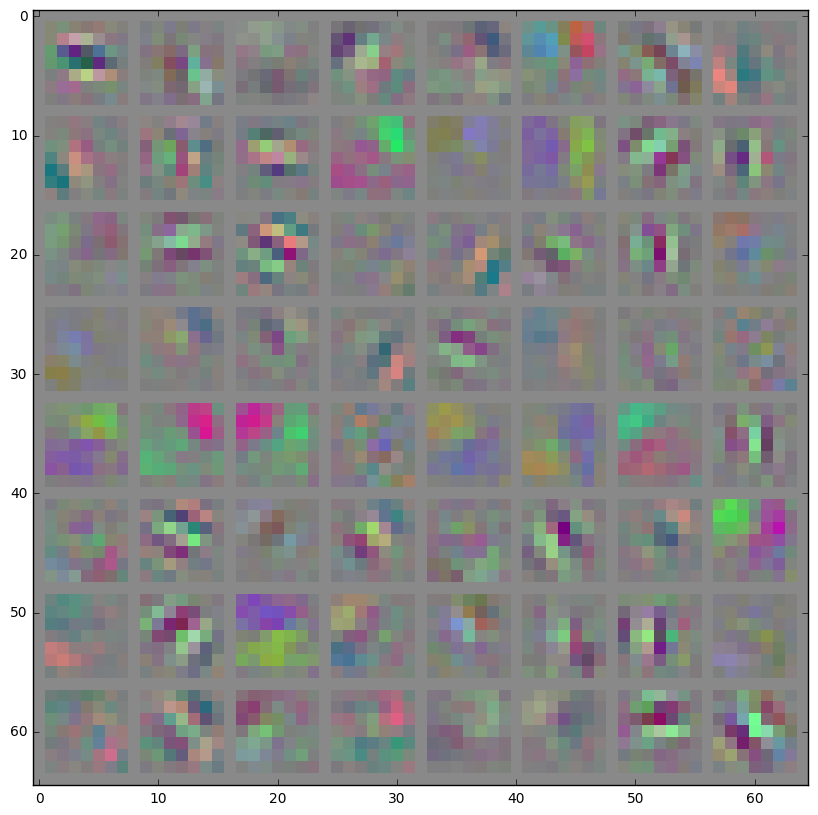

In [34]:
Ws = (Ws/ np.max(np.abs(Ws))* 128+128).astype(np.uint8)
plt.figure(figsize=(10, 10))
plt.imshow(Ws, interpolation='nearest')

In [35]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')

In [36]:
layer_shape = tf.shape(feature).eval(feed_dict={x:img_4d})
print(layer_shape)

[  1 150 150  64]


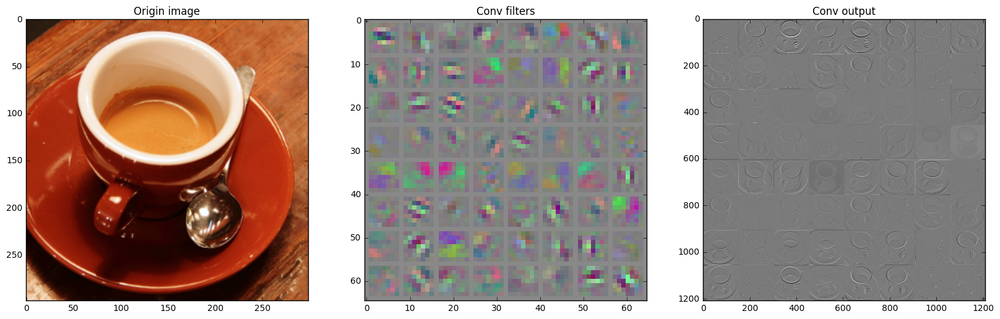

In [37]:
f = feature.eval(feed_dict={ x : img_4d})
montage = utils.montage_filters(np.rollaxis(np.expand_dims(f[0],3),3, 2))
fig, axs = plt.subplots(1, 3, figsize=(20, 10))
axs[0].imshow(inception.deprocess(img))
axs[0].set_title("Origin image")
axs[1].imshow(Ws, interpolation='nearest')
axs[1].set_title("Conv filters")
axs[2].imshow(montage, cmap='gray')
axs[2].set_title("Conv output")

# Visualizing the Gradient

In [38]:
feature.eval(feed_dict={x:img_4d}).shape

(1, 150, 150, 64)

In [39]:
tf.reduce_max(feature, 3).eval(feed_dict={x:img_4d}).shape

(1, 150, 150)

In [40]:
x.eval(feed_dict={x:img_4d}).shape

(1, 299, 299, 3)

In [41]:
feature = g.get_tensor_by_name('inception/conv2d0_pre_relu:0')
gradient = tf.gradients(tf.reduce_max(feature, 3), x)

In [42]:
len(sess.run(gradient, feed_dict={x: img_4d}))

1

In [43]:
res = sess.run(gradient, feed_dict={x: img_4d})[0]

In [44]:
res.shape

(1, 299, 299, 3)

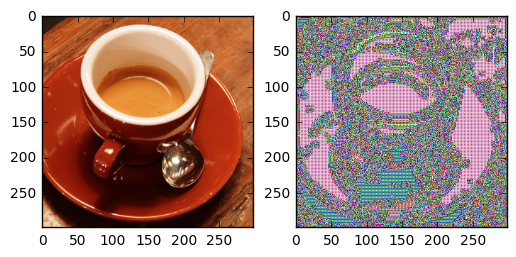

In [45]:
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(res[0])

In [46]:
def normalize(img, s=0.1):
    """
    Normalize the image range for visualization
    """
    z = img/np.std(img)
    return np.uint8(np.clip(
                (z - z.mean())/max(z.std(), 1e-4)*s + 0.5,0, 1)*255)

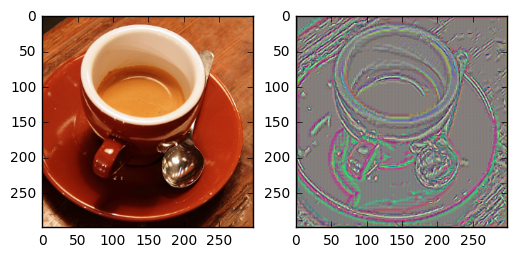

In [47]:
r = normalize(res)
fig, axs = plt.subplots(1, 2)
axs[0].imshow(inception.deprocess(img))
axs[1].imshow(r[0])

In [48]:
def compute_gradient(input_placeholder, img, layer_name, neuron_i):
    feature = g.get_tensor_by_name(layer_name)
    gradient = tf.gradients(tf.reduce_mean(feature[:, :, :, neuron_i]), x)
    res = sess.run(gradient, feed_dict={input_placeholder:img})[0]
    return res

def compute_gradients(input_placeholder, img, layer_name):
    feature = g.get_tensor_by_name(layer_name)
    layer_shape = tf.shape(feature).eval(feed_dict={input_placeholder: img})
    gradients = []
    for neuron_i in range(layer_shape[-1]):
        gradients.append(compute_gradient(input_placeholder, img, layer_name, neuron_i))
    return gradients

In [49]:
gradients = compute_gradients(x, img_4d, 'inception/conv2d1_pre_relu:0')
gradients_norm =  [normalize(gradient_i[0]) for gradient_i in gradients]
motange = utils.montage(np.array(gradients_norm))

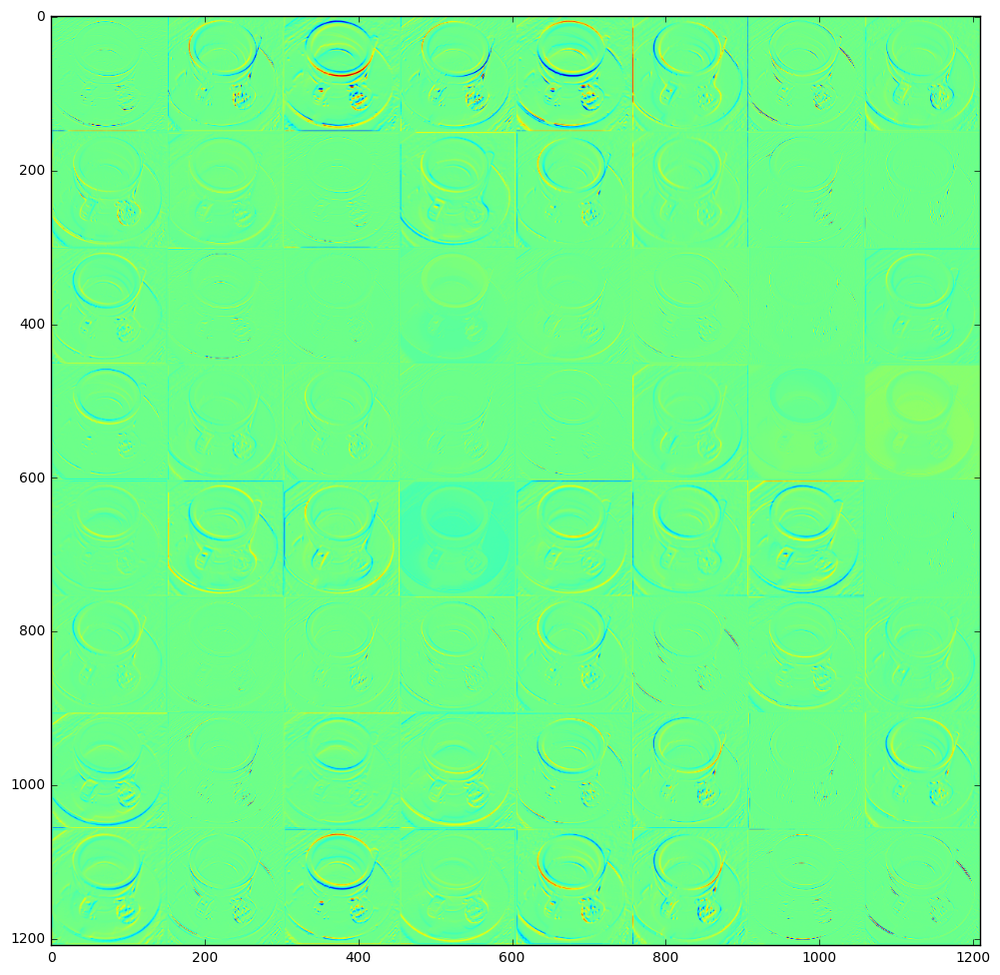

In [50]:
plt.figure(figsize=(12, 12))
plt.imshow(montage)

In [51]:
features = [name for name in names if 'maxpool' in name.split('/')[-1]]
print(features)

['inception/maxpool0', 'inception/maxpool1', 'inception/maxpool4', 'inception/maxpool10']


In [52]:
g.get_tensor_by_name('inception/maxpool0:0').eval(feed_dict={x:img_4d}).shape

(1, 75, 75, 64)

5.90585e+06
115560.0
203146.0
24223.5


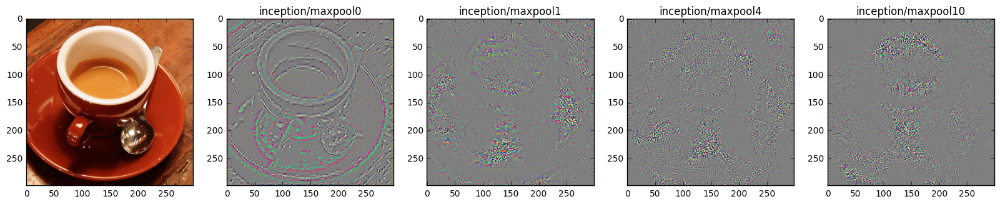

In [53]:
n_plots = len(features) + 1
fig, axs= plt.subplots(1, n_plots, figsize=(20, 5))
base = img_4d
axs[0].imshow(inception.deprocess(img))
for feature_i, featurename in enumerate(features):
    feature = g.get_tensor_by_name(featurename+':0')
    neuron = tf.reduce_max(feature, len(feature.get_shape())-1)
    print(tf.reduce_sum(neuron).eval(feed_dict={x : base}))
    # 나머지 픽셀들은 다 상수로보고 해당 픽셀 하나 가지고만 미분해서!!
    gradient = tf.gradients(tf.reduce_sum(neuron), x)
    this_res = sess.run(gradient[0], feed_dict={x : base})[0]
    axs[feature_i+1].imshow(normalize(this_res))
    axs[feature_i+1].set_title(featurename)

# Deep Dreaming

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

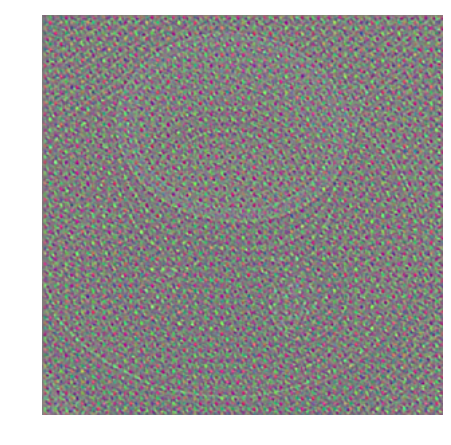

In [54]:
img_4d = img_4d / np.max(img_4d)

layer = g.get_tensor_by_name('inception/maxpool0:0')

gradient = tf.gradients(tf.reduce_mean(layer), x)

img_copy = img_4d.copy()

n_iterations = 50

step = 1.0

gif_step = 10

imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    
    this_res = sess.run(gradient[0], feed_dict={x:img_copy})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    
    img_copy += this_res * step
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))

gif.build_gif(imgs, saveto='1-simplest-mean-layer.gif')

In [55]:
ipyd.Image(url='1-simplest-mean-layer.gif',height=200, width=200)

In [56]:
neuron = tf.reduce_max(layer, len(layer.get_shape())-1)
gradient = tf.gradients(tf.reduce_mean(neuron),x )

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

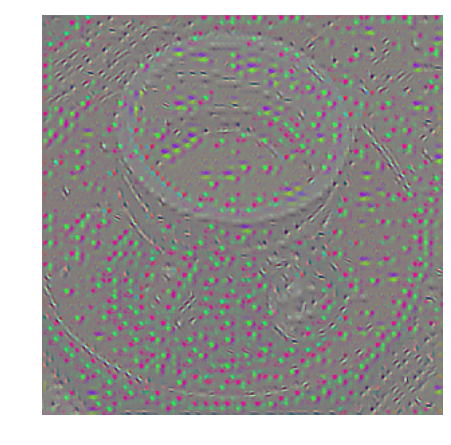

In [57]:
img_copy = img_4d.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict = {x : img_copy})[0]
    this_res /= (np.max(np.abs(this_res))+ 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='1-simplest-max-neuron.gif')

In [58]:
ipyd.Image(url='1-simplest-max-neuron.gif', height=200, width=200)

0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 0, 10, 20, 30, 40, 

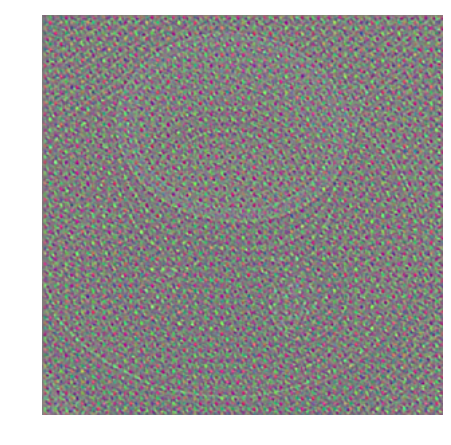

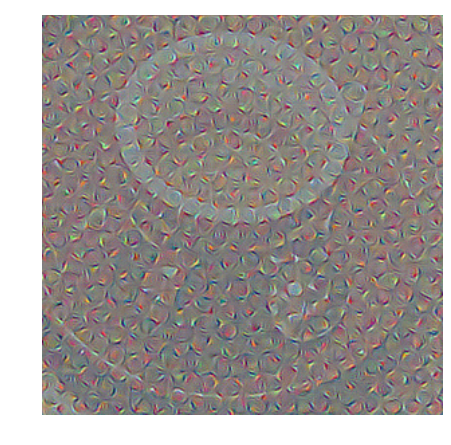

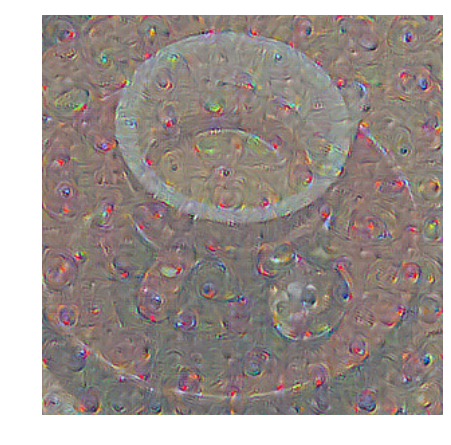

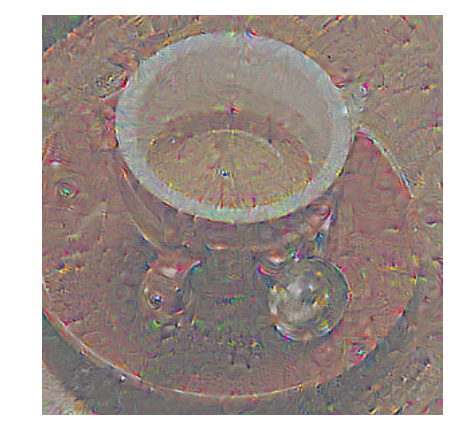

In [59]:
for feature_i in features:
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_4d.copy()
    imgs = []
    for it_i in range(n_iterations):
        if it_i % 10 == 0:
            print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x:img_copy})[0]
        this_res /= (np.max(np.abs(this_res))+ 1e-8)
        img_copy += this_res * step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(imgs, saveto='1-simplest-'+feature_i.split('/')[-1]+'.gif')

In [60]:
img_noise = inception.preprocess((np.random.randint(100, 150, size = (299, 299,3), dtype=np.uint8)))[np.newaxis]
print(img_noise.min(), img_noise.max())

-17.0 32.0


In [61]:
img_noise.shape

(1, 299, 299, 3)

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 

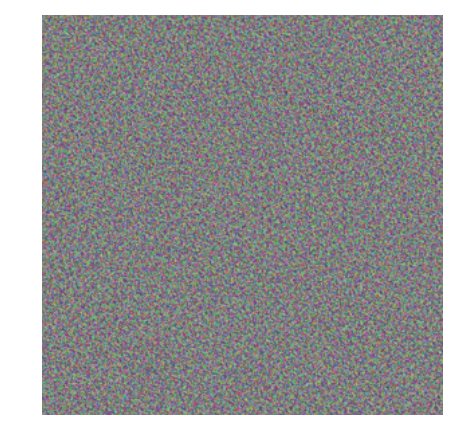

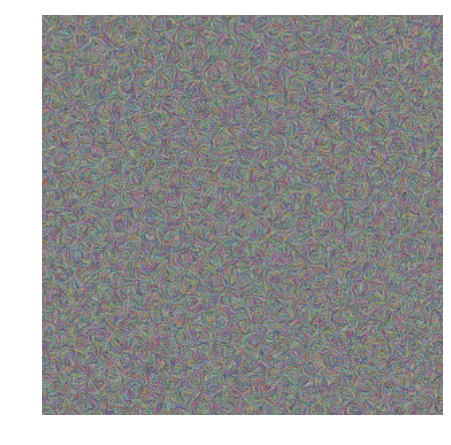

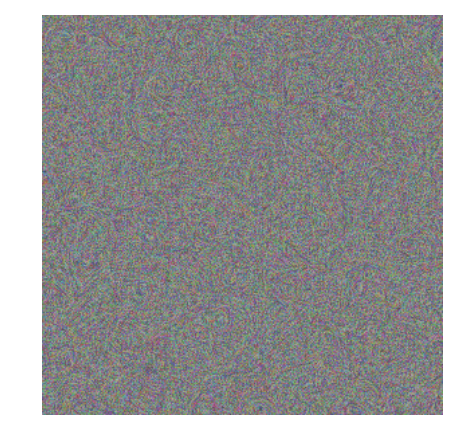

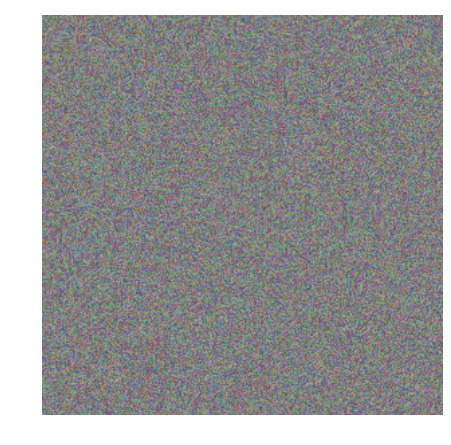

In [62]:
for feature_i in features: 
    layer = g.get_tensor_by_name(feature_i + ':0')
    gradient = tf.gradients(tf.reduce_mean(layer), x)
    img_copy = img_noise.copy()
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy})[0]
        this_res /= (np.max(np.abs(this_res))+ 1e-8)
        img_copy += this_res*step
        if it_i % gif_step == 0:
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(
        imgs, saveto='1-simplest-noise-'+feature_i.split('/')[-1]+'.gif')

# Specifying the Object

In [63]:
layer = g.get_tensor_by_name('inception/mixed5b_pool_reduce_pre_relu:0')

layer_shape = tf.shape(layer).eval(feed_dict={x:img_4d})
n_els = tf.shape(layer).eval(feed_dict={x:img_4d})[-1]

neuron_i = np.random.randint(n_els)
layer_vec = np.zeros(layer_shape)

layer_vec[..., neuron_i] = 1

neuron = tf.reduce_max(layer, len(layer.get_shape()) -1 )
gradient = tf.gradients(tf.reduce_mean(neuron), x)

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 

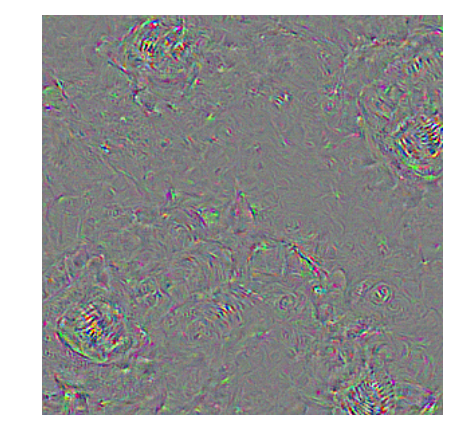

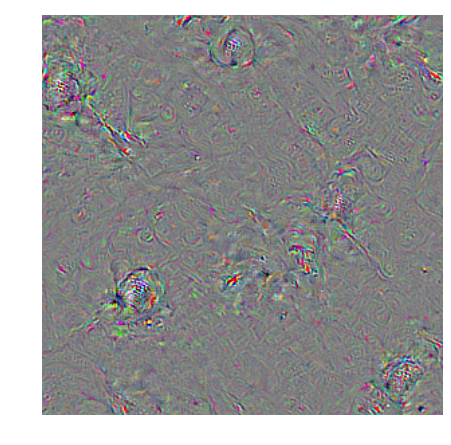

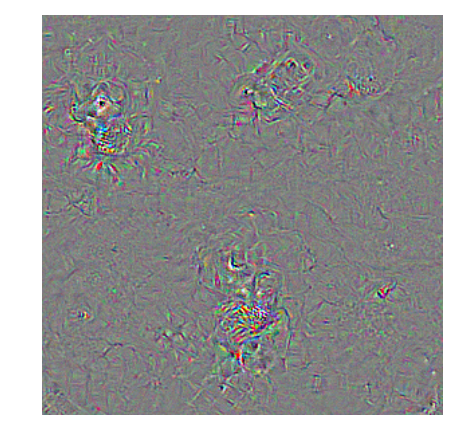

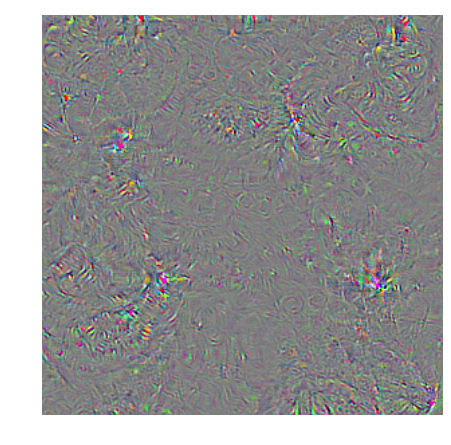

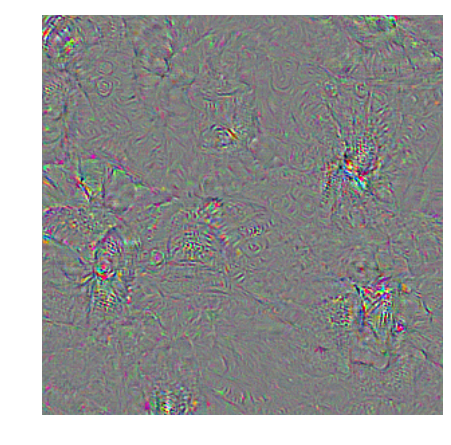

In [64]:
n_iterations = 30

for i in range(5):
    neuron_i = np.random.randint(n_els)
    layer_vec = np.zeros(layer_shape)
    layer_vec[..., neuron_i] = 1
    img_copy = img_noise.copy()/255.0
    imgs = []
    for it_i in range(n_iterations):
        print(it_i, end=', ')
        this_res = sess.run(gradient[0], feed_dict={x: img_copy, layer: layer_vec})[0]
        this_res /= (np.max(np.abs(this_res)) + 1e-8)
        img_copy += this_res*step 
        if it_i % gif_step == 0 :
            imgs.append(normalize(img_copy[0]))
    gif.build_gif(imgs, saveto='2-objective-' + str(neuron_i) + '.gif')

In [65]:
net['labels']

[(0, 'dummy'),
 (1, 'kit fox'),
 (2, 'English setter'),
 (3, 'Siberian husky'),
 (4, 'Australian terrier'),
 (5, 'English springer'),
 (6, 'grey whale'),
 (7, 'lesser panda'),
 (8, 'Egyptian cat'),
 (9, 'ibex'),
 (10, 'Persian cat'),
 (11, 'cougar'),
 (12, 'gazelle'),
 (13, 'porcupine'),
 (14, 'sea lion'),
 (15, 'malamute'),
 (16, 'badger'),
 (17, 'Great Dane'),
 (18, 'Walker hound'),
 (19, 'Welsh springer spaniel'),
 (20, 'whippet'),
 (21, 'Scottish deerhound'),
 (22, 'killer whale'),
 (23, 'mink'),
 (24, 'African elephant'),
 (25, 'Weimaraner'),
 (26, 'soft-coated wheaten terrier'),
 (27, 'Dandie Dinmont'),
 (28, 'red wolf'),
 (29, 'Old English sheepdog'),
 (30, 'jaguar'),
 (31, 'otterhound'),
 (32, 'bloodhound'),
 (33, 'Airedale'),
 (34, 'hyena'),
 (35, 'meerkat'),
 (36, 'giant schnauzer'),
 (37, 'titi'),
 (38, 'three-toed sloth'),
 (39, 'sorrel'),
 (40, 'black-footed ferret'),
 (41, 'dalmatian'),
 (42, 'black-and-tan coonhound'),
 (43, 'papillon'),
 (44, 'skunk'),
 (45, 'Staffordsh

In [66]:
type(net['labels'])

list

In [67]:
neuron_i = 962
print(net['labels'][neuron_i])

(962, 'school bus')


In [68]:
layer = g.get_tensor_by_name(names[-1] + ':0')
gradient = tf.gradients(tf.reduce_max(layer), x)
layer_shape = tf.shape(layer).eval(feed_dict = {x: img_noise})
layer_vec = np.zeros(layer_shape)
layer_vec[..., neuron_i]= 1

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

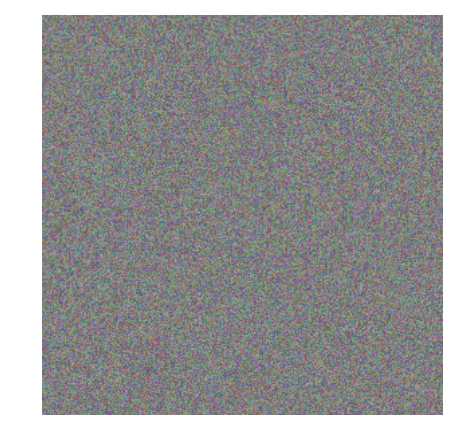

In [69]:
n_iterations = 300
gif_step = 10
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={x: img_copy, layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res))+ 1e-8)
    img_copy += this_res * step
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='2-object-'+str(neuron_i) + '.gif')

In [70]:
# Test

(1, 299, 299, 3)
[[  1.04122091e-06   3.98934117e-06   7.65114328e-06 ...,   1.04114451e-06
    1.04126570e-06   1.04121602e-06]
 [  6.78790286e-07   2.41298744e-06   4.39535143e-06 ...,   6.78741117e-07
    6.78820072e-07   6.78787046e-07]
 [  9.36846050e-07   3.04278342e-06   4.49913023e-06 ...,   9.36777212e-07
    9.36885272e-07   9.36842468e-07]
 ..., 
 [  1.20446668e-06   9.72130056e-06   2.65794333e-05 ...,   1.20437937e-06
    1.20451944e-06   1.20446089e-06]
 [  1.74172419e-06   1.27833628e-05   3.15190518e-05 ...,   1.74159641e-06
    1.74179729e-06   1.74171430e-06]
 [  3.58401576e-06   2.60114703e-05   5.42359885e-05 ...,   3.58375610e-06
    3.58417265e-06   3.58400212e-06]]


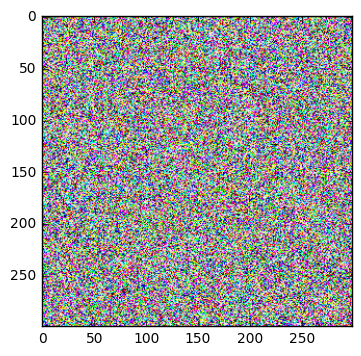

In [71]:

test = inception.preprocess(imgs[2])
plt.imshow(test)
test = test[np.newaxis]

print(test.shape)

output = g.get_tensor_by_name(names[-1]+':0')

res = sess.run(output, feed_dict={x: test})
print(res)

In [72]:
dict(net['labels'])[np.argmax(res[0])]

'shower curtain'

# Decaying the Gradient

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

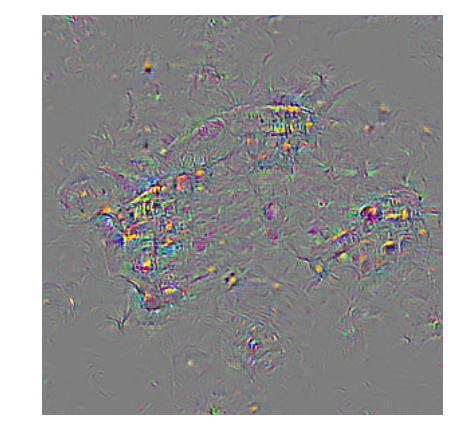

In [73]:
decay = 0.95

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy,
        layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='3-decay-' + str(neuron_i) + '.gif')

# Blurring  the Gradient

In [74]:
from scipy.ndimage.filters import gaussian_filter

sigma = 1.0
blur_step = 5

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

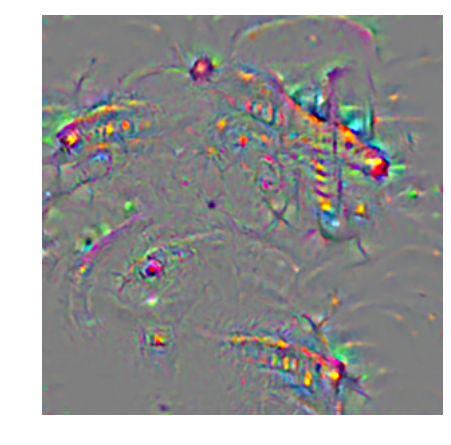

In [75]:
img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end=', ')
    this_res = sess.run(gradient[0], feed_dict={ x: img_copy, layer: layer_vec})[0]
    this_res /= (np.max(np.abs(this_res))+1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
    if it_i % gif_step ==0 :
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='4-gaussian-'+str(neuron_i)+'.gif')

In [76]:
ipyd.Image(url='4-gaussian-962.gif', height=300, width=300)

# Clipping Gradients

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

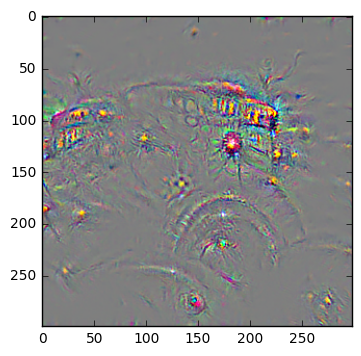

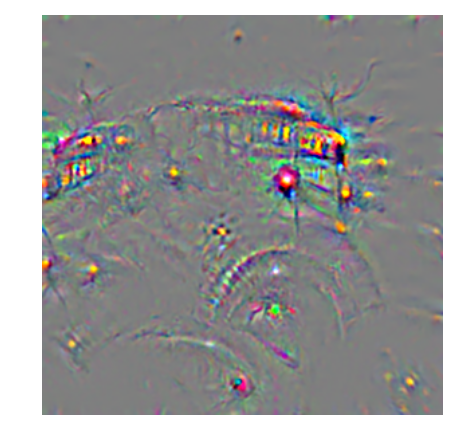

In [77]:
pth = 5

img_copy = img_noise.copy()
imgs = []
for it_i in range(n_iterations):
    print(it_i, end = ', ')
    this_res = sess.run(gradient[0], feed_dict={
        x: img_copy, 
        layer: layer_vec})[0]
    
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
    
    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy* mask
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
plt.imshow(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='5-clip-' + str(neuron_i)+'.gif')

In [78]:
ipyd.Image(url='5-clip-962.gif', height=300, width=300)

# Infinite Zoom / Fractal

In [79]:
from skimage.transform import resize

0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 

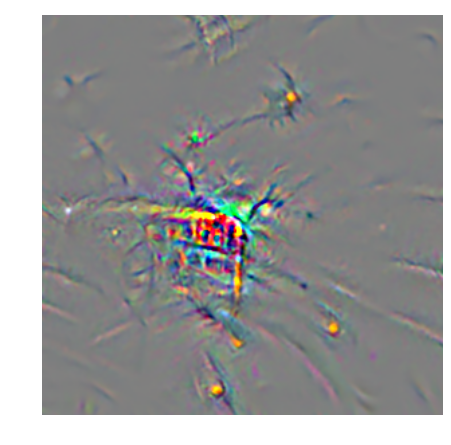

In [80]:
img_copy = img_noise.copy()
crop = 1
n_iterations = 1000
imgs = []
n_img, height, width, ch = img_copy.shape
for it_i in range(n_iterations):
    print(it_i, end =', ')
    this_res = sess.run(gradient[0], feed_dict={ x: img_copy, layer : layer_vec})[0]
    this_res /= (np.max(np.abs(this_res)) + 1e-8)
    img_copy += this_res * step
    img_copy *= decay
    
    if it_i % blur_step == 0:
        for ch_i in range(3):
            img_copy[..., ch_i] = gaussian_filter(img_copy[..., ch_i], sigma)
            
    mask = (abs(img_copy) < np.percentile(abs(img_copy), pth))
    img_copy = img_copy - img_copy * mask
    img_copy = img_copy[:, crop:-crop, crop: -crop, :]
    
    img_copy = resize(img_copy[0], (height, width), order=3, 
                         clip=False, preserve_range=True)[np.newaxis].astype(np.float32)
    
    if it_i % gif_step == 0:
        imgs.append(normalize(img_copy[0]))
gif.build_gif(imgs, saveto='6-fractal.gif')

In [81]:
ipyd.Image(url='6-fractal.gif', height=300, width=300)

# Style Net

In [136]:
import tensorflow as tf
from libs import utils

In [137]:
from tensorflow.python.framework.ops import reset_default_graph
sess.close()
reset_default_graph()

# VGG 16

In [138]:
from libs import vgg16
net =vgg16.get_vgg_model()

In [139]:
g = tf.Graph()
with tf.Session(graph=g) as sess: # g.device('/cpu:0')
    tf.import_graph_def(net['graph_def'], name='vgg')
    names = [op.name for op in g.get_operations()]

In [140]:
nb_utils.show_graph(net['graph_def'])

In [141]:
print(names)

['vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv3_2', 'vgg/conv3_3/filter', 'vgg/conv3_3/Conv2D', 'vgg/conv3_3/biases', 'vgg/conv3_3/BiasAdd', 'vgg/conv3_3/conv3_

In [142]:
x = g.get_tensor_by_name(names[0] +':0')
softmax = g.get_tensor_by_name(names[-2]+ ':0')

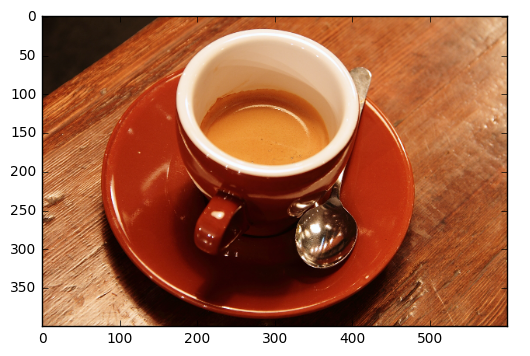

In [143]:
from skimage.data import coffee
og = coffee()
plt.imshow(og)

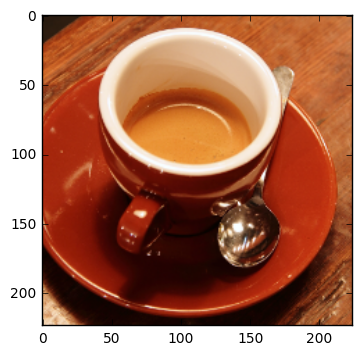

In [144]:
img=vgg16.preprocess(og)
plt.imshow(img)

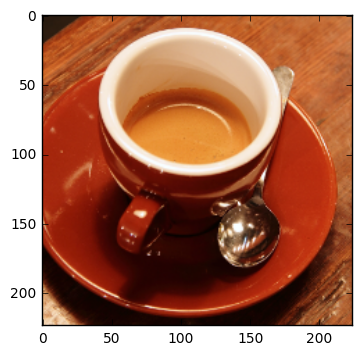

In [145]:
plt.imshow(vgg16.deprocess(img))

In [146]:
vgg16.deprocess(img)

array([[[ 39,  26,  15],
        [ 40,  27,  16],
        [ 39,  26,  16],
        ..., 
        [204, 128,  75],
        [206, 129,  76],
        [209, 133,  78]],

       [[ 39,  26,  15],
        [ 41,  28,  17],
        [ 39,  26,  15],
        ..., 
        [207, 129,  76],
        [207, 131,  79],
        [206, 132,  80]],

       [[ 39,  26,  15],
        [ 41,  28,  17],
        [ 40,  27,  16],
        ..., 
        [205, 131,  78],
        [198, 125,  77],
        [189, 117,  70]],

       ..., 
       [[238, 200, 161],
        [237, 202, 165],
        [243, 215, 181],
        ..., 
        [176,  90,  43],
        [202, 113,  61],
        [184, 103,  49]],

       [[241, 206, 170],
        [239, 210, 177],
        [242, 209, 174],
        ..., 
        [200, 111,  62],
        [183, 106,  53],
        [167,  83,  37]],

       [[240, 203, 169],
        [243, 210, 178],
        [234, 198, 163],
        ..., 
        [174,  95,  46],
        [165,  86,  45],
        [195, 104,

In [147]:
img_4d = img[np.newaxis]
with tf.Session(graph=g) as sess : #g.device('/cpu:0')
    res = softmax.eval(feed_dict={x: img_4d})[0]
    print([(res[idx], net['labels'][idx])
          for idx in res.argsort()[-5:][::-1]])

[(0.96806115, (967, 'n07920052 espresso')), (0.0094829015, (925, 'n07584110 consomme')), (0.0060893712, (960, 'n07836838 chocolate sauce, chocolate syrup')), (0.0059838379, (868, 'n04476259 tray')), (0.0058111171, (968, 'n07930864 cup'))]


In [148]:
[name_i for name_i in names if 'dropout' in name_i]

['vgg/dropout/Shape',
 'vgg/dropout/random_uniform/min',
 'vgg/dropout/random_uniform/range',
 'vgg/dropout/random_uniform/RandomUniform',
 'vgg/dropout/random_uniform/mul',
 'vgg/dropout/random_uniform',
 'vgg/dropout/add/x',
 'vgg/dropout/add',
 'vgg/dropout/Floor',
 'vgg/dropout/mul/y',
 'vgg/dropout/mul',
 'vgg/dropout/mul_1',
 'vgg/dropout_1/Shape',
 'vgg/dropout_1/random_uniform/min',
 'vgg/dropout_1/random_uniform/range',
 'vgg/dropout_1/random_uniform/RandomUniform',
 'vgg/dropout_1/random_uniform/mul',
 'vgg/dropout_1/random_uniform',
 'vgg/dropout_1/add/x',
 'vgg/dropout_1/add',
 'vgg/dropout_1/Floor',
 'vgg/dropout_1/mul/y',
 'vgg/dropout_1/mul',
 'vgg/dropout_1/mul_1']

In [149]:
with tf.Session(graph=g) as sess:
    res = softmax.eval(feed_dict= {
        x:img_4d, 
        'vgg/dropout_1/random_uniform:0':[[1.0]*4096],
        'vgg/dropout/random_uniform:0':[[1.0]*4096]})[0]
print([(res[idx], net['labels'][idx])
      for idx in res.argsort()[-5:][::-1]])

[(0.99999619, (967, 'n07920052 espresso')), (3.868814e-06, (968, 'n07930864 cup')), (5.4153537e-10, (504, 'n03063599 coffee mug')), (3.8138565e-10, (960, 'n07836838 chocolate sauce, chocolate syrup')), (3.2199923e-10, (925, 'n07584110 consomme'))]


# Defining the Content Features

In [150]:
with tf.Session(graph=g) as sess:
    content_layer = 'vgg/conv4_2/conv4_2:0'
    content_features = g.get_tensor_by_name(content_layer).eval(
            session=sess,
            feed_dict={x: img_4d,
                      'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
                      'vgg/dropout/random_uniform:0': [[1.0]*4096]})
print(content_features.shape)

(1, 28, 28, 512)


# Defineing the Style Features

In [151]:
filepath = utils.download('https://upload.wikimedia.org/wikipedia/commons/thumb/a/ae/El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg/640px-El_jard%C3%ADn_de_las_Delicias%2C_de_El_Bosco.jpg')

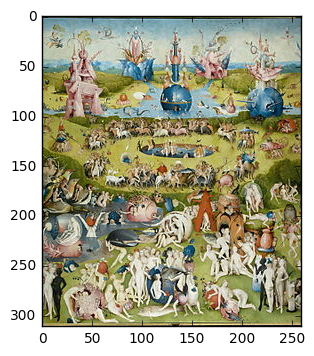

In [152]:
# Note: Unlike in the lecture, I've cropped the image a bit as the borders took over too much...
style_og = plt.imread(filepath)[15:-15, 190:-190, :]
plt.imshow(style_og)

In [153]:
style_img = vgg16.preprocess(style_og)
style_img_4d = style_img[np.newaxis]

In [154]:
with tf.Session(graph=g) as sess:
    res = softmax.eval(
        feed_dict={
            x: style_img_4d,
            'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
            'vgg/dropout/random_uniform:0': [[1.0]*4096]})[0]
print([(res[idx], net['labels'][idx])
       for idx in res.argsort()[-5:][::-1]])

[(0.99336135, (611, 'n03598930 jigsaw puzzle')), (0.0052440548, (868, 'n04476259 tray')), (0.0011667105, (591, 'n03485794 handkerchief, hankie, hanky, hankey')), (0.00011143509, (865, 'n04462240 toyshop')), (4.7309302e-05, (917, 'n06596364 comic book'))]


In [155]:
style_layers = ['vgg/conv1_1/conv1_1:0',
                'vgg/conv2_1/conv2_1:0',
                'vgg/conv3_1/conv3_1:0',
                'vgg/conv4_1/conv4_1:0',
                'vgg/conv5_1/conv5_1:0']

style_activations = []

with tf.Session(graph=g) as sess :
    for style_i in style_layers:
        style_activation_i = g.get_tensor_by_name(style_i).eval(
            feed_dict={
                x:style_img_4d,
                'vgg/dropout_1/random_uniform:0': [[1.0]*4096],
                'vgg/dropout/random_uniform:0': [[1.0]*4096]})
        style_activations.append(style_activation_i)

In [156]:
style_activations[0].shape

(1, 224, 224, 64)

In [157]:
style_features = []
for style_activation_i in style_activations:
    s_i = np.reshape(style_activation_i, [-1, style_activation_i.shape[-1]])
    gram_matrix = np.matmul(s_i.T, s_i) / s_i.size
    print("s_i.shape : {}, gram_matrix.shape : {}".format(s_i.shape, gram_matrix.shape))
    style_features.append(gram_matrix.astype(np.float32))

s_i.shape : (50176, 64), gram_matrix.shape : (64, 64)
s_i.shape : (12544, 128), gram_matrix.shape : (128, 128)
s_i.shape : (3136, 256), gram_matrix.shape : (256, 256)
s_i.shape : (784, 512), gram_matrix.shape : (512, 512)
s_i.shape : (196, 512), gram_matrix.shape : (512, 512)


### Remapping the input

In [158]:
reset_default_graph()
g = tf.Graph()

In [159]:
net = vgg16.get_vgg_model()

with tf.Session(graph=g) as sess:
    net_input = tf.Variable(img_4d, name='variable_for_remap', trainable=True)
    
    tf.import_graph_def(
        net['graph_def'],
        name='vgg',
        input_map={'images:0':net_input})

In [160]:
names = [op.name for op in g.get_operations()]
print(names)

['variable_for_remap/initial_value', 'variable_for_remap', 'variable_for_remap/Assign', 'variable_for_remap/read', 'vgg/images', 'vgg/mul/y', 'vgg/mul', 'vgg/split/split_dim', 'vgg/split', 'vgg/sub/y', 'vgg/sub', 'vgg/sub_1/y', 'vgg/sub_1', 'vgg/sub_2/y', 'vgg/sub_2', 'vgg/concat/concat_dim', 'vgg/concat', 'vgg/conv1_1/filter', 'vgg/conv1_1/Conv2D', 'vgg/conv1_1/biases', 'vgg/conv1_1/BiasAdd', 'vgg/conv1_1/conv1_1', 'vgg/conv1_2/filter', 'vgg/conv1_2/Conv2D', 'vgg/conv1_2/biases', 'vgg/conv1_2/BiasAdd', 'vgg/conv1_2/conv1_2', 'vgg/pool1', 'vgg/conv2_1/filter', 'vgg/conv2_1/Conv2D', 'vgg/conv2_1/biases', 'vgg/conv2_1/BiasAdd', 'vgg/conv2_1/conv2_1', 'vgg/conv2_2/filter', 'vgg/conv2_2/Conv2D', 'vgg/conv2_2/biases', 'vgg/conv2_2/BiasAdd', 'vgg/conv2_2/conv2_2', 'vgg/pool2', 'vgg/conv3_1/filter', 'vgg/conv3_1/Conv2D', 'vgg/conv3_1/biases', 'vgg/conv3_1/BiasAdd', 'vgg/conv3_1/conv3_1', 'vgg/conv3_2/filter', 'vgg/conv3_2/Conv2D', 'vgg/conv3_2/biases', 'vgg/conv3_2/BiasAdd', 'vgg/conv3_2/conv

## Defining the Content Loss

In [161]:
with tf.Session(graph=g) as sess:
    content_loss = tf.nn.l2_loss((g.get_tensor_by_name(content_layer) - 
                                 content_features) /
                                 content_features.size)

## Defining the Style Loss

In [162]:
with tf.Session(graph=g) as sess:
    style_loss = np.float32(0.0)
    for style_layer_i, style_gram_i in zip(style_layers, style_features):
        layer_i = g.get_tensor_by_name(style_layer_i)
        layer_shape = layer_i.get_shape().as_list()
        layer_size = layer_shape[1] * layer_shape[2] * layer_shape[3]
        layer_flat = tf.reshape(layer_i, [-1, layer_shape[3]])
        gram_matrix = tf.matmul(tf.transpose(layer_flat), layer_flat)/ layer_size
        style_loss = tf.add(style_loss, tf.nn.l2_loss((gram_matrix - style_gram_i)/ np.float32(style_gram_i.size)))

In [163]:
a = np.array([[1,2,3,]])

In [164]:
a

array([[1, 2, 3]])

In [165]:
a.transpose()*a

array([[1, 2, 3],
       [2, 4, 6],
       [3, 6, 9]])

## Defining the Total Variation Loss

In [166]:
def total_variation_loss(x):
    h, w = x.get_shape().as_list()[1], x.get_shape().as_list()[1]
    dx = tf.square(x[:, :h-1, w-1, :] - x[:, :h-1, 1:, :])
    dy = tf.square(x[:, :h-1, w-1, :] - x[:, 1:, :w-1, :])
    return tf.reduce_sum(tf.pow(dx + dy, 1.25))

with tf.Session(graph=g) as sess:
    tv_loss = total_variation_loss(net_input)

# Training 

In [167]:
with tf.Session(graph=g) as sess:
    loss = 0.1 * content_loss + 5.0 * style_loss + 0.01* tv_loss
    optimizer = tf.train.AdamOptimizer(0.01).minimize(loss)

0: 213.48379516601562, 0.0, - 1.0


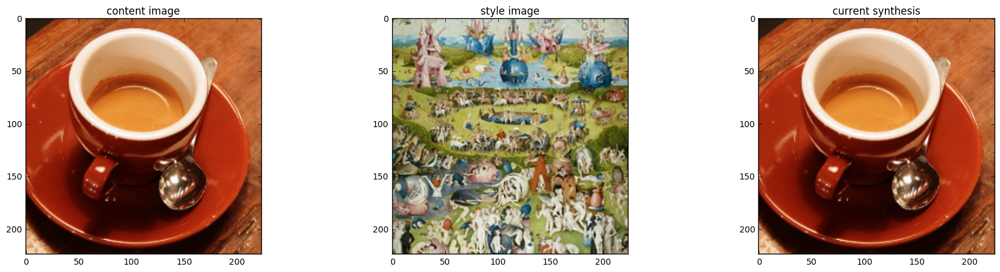

1: 195.78045654296875, -0.009999154135584831, - 1.0099986791610718
2: 179.58535766601562, -0.019981402903795242, - 1.019576072692871
3: 164.8706817626953, -0.02999391034245491, - 1.0294914245605469
4: 151.58602905273438, -0.039849571883678436, - 1.0389851331710815
5: 139.687744140625, -0.04945063591003418, - 1.0484943389892578


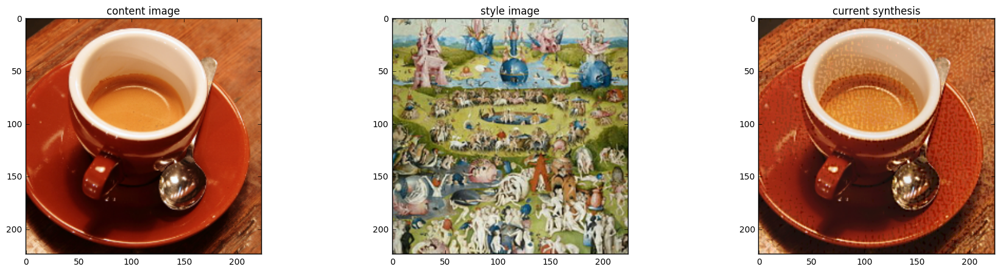

6: 129.10203552246094, -0.058961380273103714, - 1.0578281879425049
7: 119.7041244506836, -0.06803566217422485, - 1.0665826797485352
8: 111.32508087158203, -0.07701914757490158, - 1.0737398862838745
9: 103.79256439208984, -0.08514369279146194, - 1.078681230545044
10: 96.9569091796875, -0.09213708341121674, - 1.0812715291976929


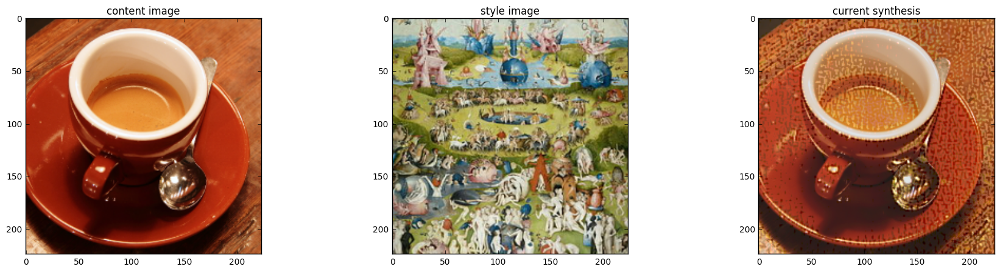

11: 90.70547485351562, -0.0994589626789093, - 1.0846233367919922
12: 84.96351623535156, -0.10656038671731949, - 1.090746521949768
13: 79.68643188476562, -0.11267998069524765, - 1.0960642099380493
14: 74.84613800048828, -0.11783619225025177, - 1.100690245628357
15: 70.41958618164062, -0.12204736471176147, - 1.104745626449585


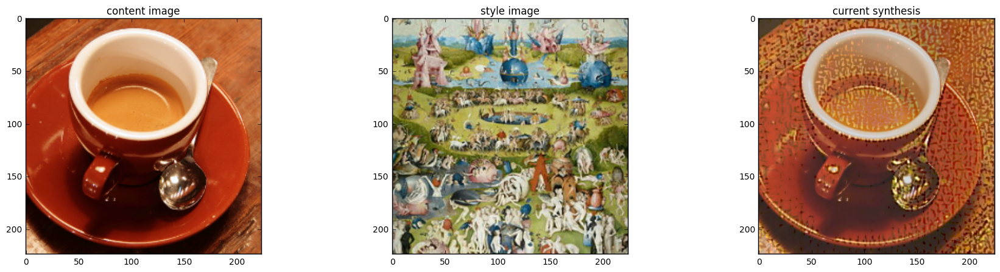

16: 66.38188171386719, -0.12535981833934784, - 1.1083651781082153
17: 62.7010383605957, -0.12787605822086334, - 1.1116654872894287
18: 59.34105682373047, -0.12966258823871613, - 1.114712119102478
19: 56.262638092041016, -0.13079394400119781, - 1.1175997257232666
20: 53.430824279785156, -0.1313534677028656, - 1.121720790863037


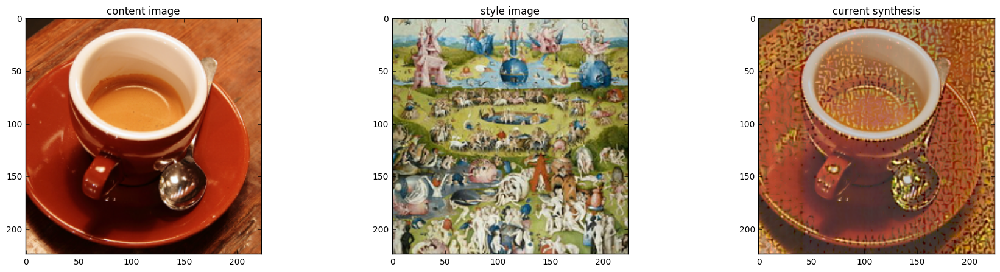

21: 50.815277099609375, -0.1332177221775055, - 1.1281720399856567
22: 48.392555236816406, -0.13833467662334442, - 1.134901762008667
23: 46.14748764038086, -0.14541949331760406, - 1.141772747039795
24: 44.06890869140625, -0.1546364426612854, - 1.1486749649047852
25: 42.14885330200195, -0.16390472650527954, - 1.1553804874420166


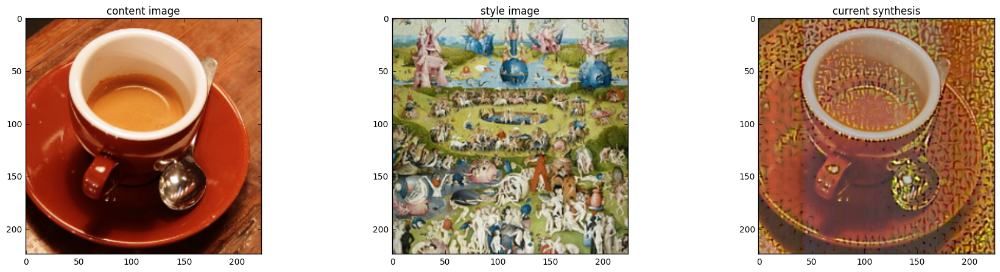

26: 40.380027770996094, -0.17321327328681946, - 1.1616225242614746
27: 38.7519645690918, -0.18249714374542236, - 1.1671602725982666
28: 37.252349853515625, -0.19169069826602936, - 1.1717238426208496
29: 35.86827087402344, -0.2007191777229309, - 1.175106167793274
30: 34.587406158447266, -0.20954781770706177, - 1.1771444082260132


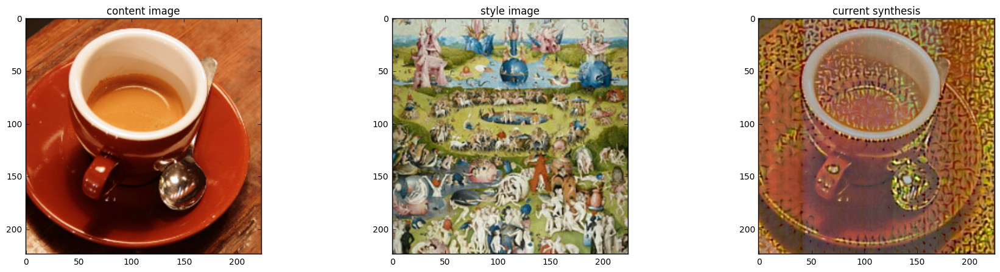

31: 33.39903259277344, -0.2182360738515854, - 1.1778234243392944
32: 32.29620361328125, -0.22677911818027496, - 1.177217960357666
33: 31.274330139160156, -0.23520655930042267, - 1.1754156351089478
34: 30.329681396484375, -0.24358780682086945, - 1.1725280284881592
35: 29.45858383178711, -0.2519185543060303, - 1.1686824560165405


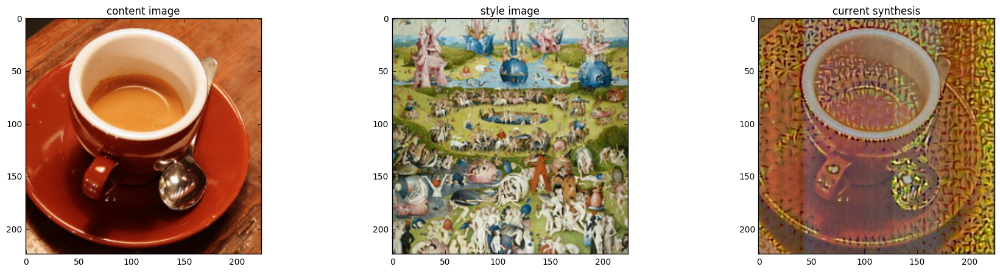

36: 28.655563354492188, -0.26026907563209534, - 1.1640769243240356
37: 27.91412925720215, -0.26870840787887573, - 1.1588351726531982
38: 27.227224349975586, -0.2772889733314514, - 1.1530547142028809
39: 26.588092803955078, -0.28607529401779175, - 1.1468071937561035
40: 25.99162483215332, -0.29503509402275085, - 1.1401344537734985


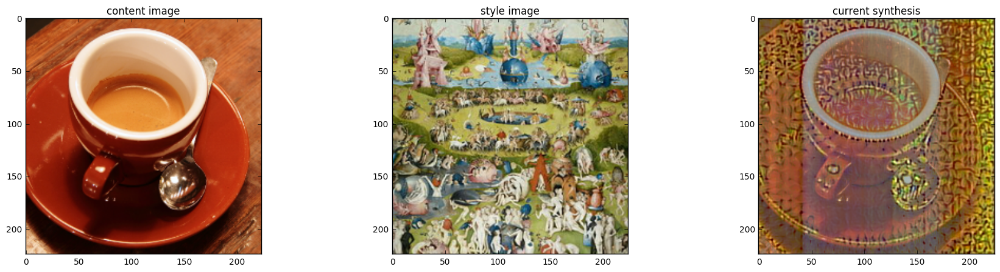

41: 25.43423080444336, -0.30414363741874695, - 1.1330572366714478
42: 24.9123477935791, -0.3134007751941681, - 1.125613808631897
43: 24.423181533813477, -0.32277265191078186, - 1.1178048849105835
44: 23.96343231201172, -0.33219876885414124, - 1.1096302270889282
45: 23.529598236083984, -0.34165358543395996, - 1.1035183668136597


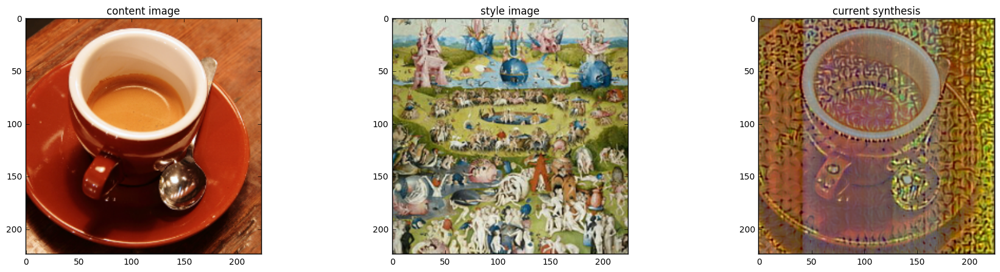

46: 23.118389129638672, -0.3511139750480652, - 1.0989735126495361
47: 22.726409912109375, -0.3605663478374481, - 1.0942480564117432
48: 22.351415634155273, -0.37004536390304565, - 1.0893664360046387
49: 21.99199867248535, -0.37958186864852905, - 1.0843579769134521
50: 21.64781379699707, -0.3891957998275757, - 1.0792579650878906


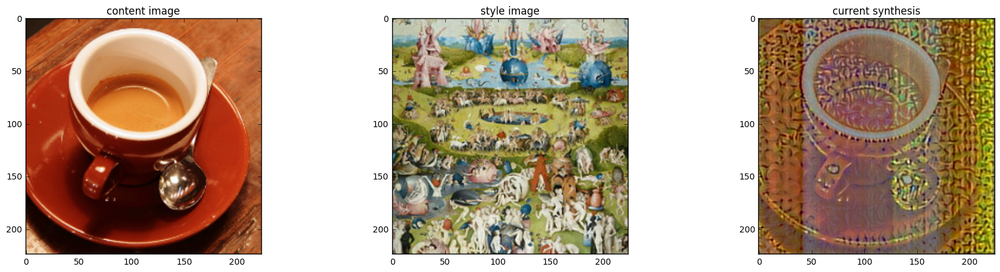

51: 21.31853675842285, -0.3989214599132538, - 1.0741010904312134
52: 21.003345489501953, -0.408782958984375, - 1.072158694267273
53: 20.70126724243164, -0.4187961518764496, - 1.0764832496643066
54: 20.411605834960938, -0.4289681911468506, - 1.080617070198059
55: 20.133535385131836, -0.4393105208873749, - 1.084560513496399


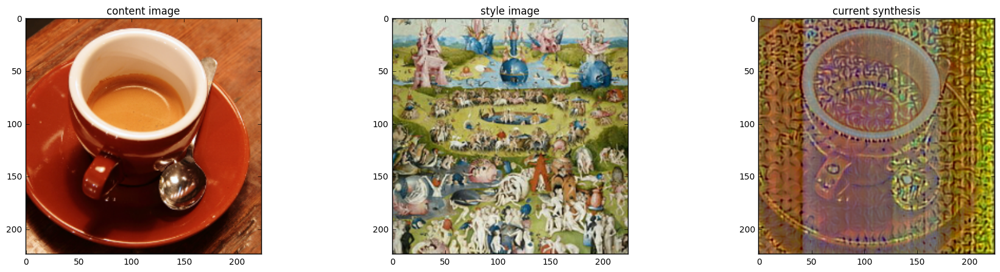

56: 19.866592407226562, -0.44980716705322266, - 1.0883119106292725
57: 19.610763549804688, -0.46045055985450745, - 1.0917651653289795
58: 19.365488052368164, -0.47120848298072815, - 1.0948306322097778
59: 19.130321502685547, -0.4820648431777954, - 1.0973761081695557
60: 18.904420852661133, -0.4929976463317871, - 1.0992789268493652


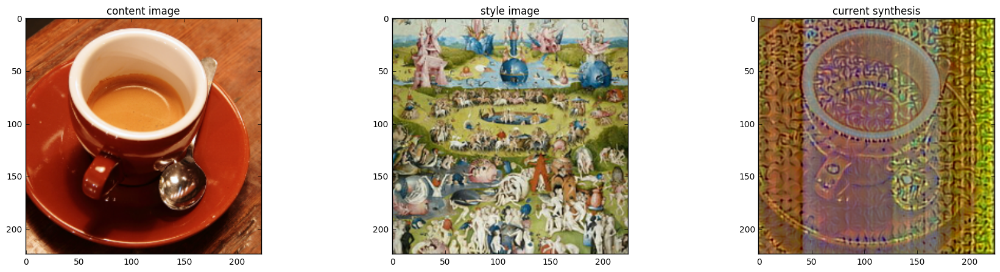

61: 18.68736457824707, -0.5039969086647034, - 1.1006373167037964
62: 18.47852897644043, -0.515059232711792, - 1.101405143737793
63: 18.277191162109375, -0.5261868238449097, - 1.1015129089355469
64: 18.08331298828125, -0.5373988151550293, - 1.1011501550674438
65: 17.8966064453125, -0.5487060546875, - 1.1004197597503662


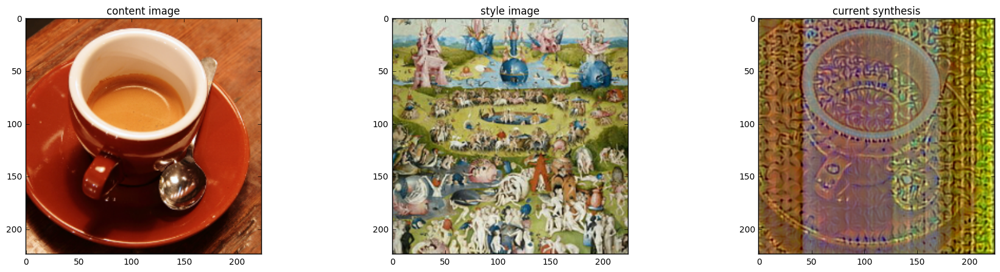

66: 17.717041015625, -0.5601426362991333, - 1.1013513803482056
67: 17.544252395629883, -0.5717162489891052, - 1.1049106121063232
68: 17.37818717956543, -0.5834536552429199, - 1.108001708984375
69: 17.218658447265625, -0.5953518748283386, - 1.1115195751190186
70: 17.065170288085938, -0.6074070930480957, - 1.1167041063308716


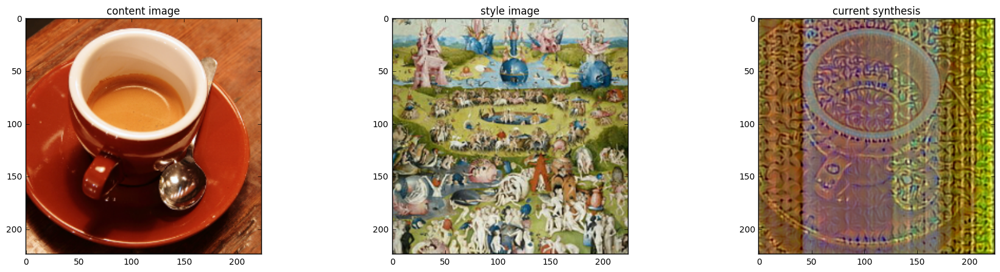

71: 16.917503356933594, -0.6195912957191467, - 1.1215177774429321
72: 16.775474548339844, -0.6318817138671875, - 1.1259026527404785
73: 16.63884162902832, -0.6442644596099854, - 1.1297447681427002
74: 16.507423400878906, -0.6567286252975464, - 1.1329801082611084
75: 16.380767822265625, -0.6692652106285095, - 1.1355425119400024


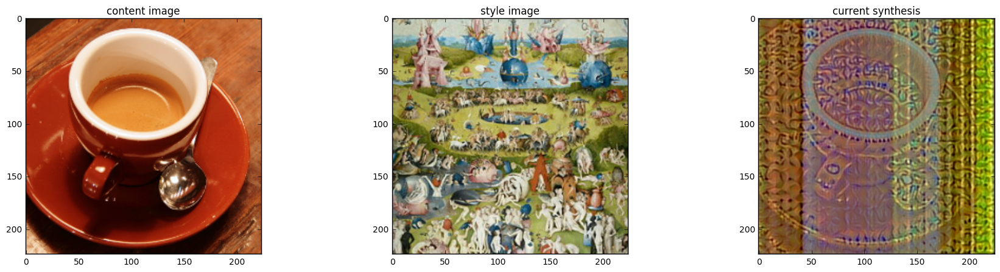

76: 16.258441925048828, -0.6818664073944092, - 1.1374658346176147
77: 16.140161514282227, -0.6945368647575378, - 1.1387934684753418
78: 16.0261287689209, -0.7072862982749939, - 1.1395841836929321
79: 15.916582107543945, -0.7201187610626221, - 1.1398868560791016
80: 15.811348915100098, -0.733024537563324, - 1.1432150602340698


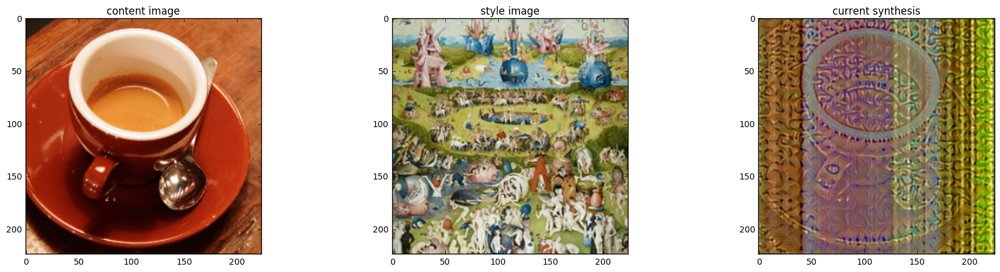

81: 15.710088729858398, -0.7460039854049683, - 1.1470024585723877
82: 15.612680435180664, -0.759057879447937, - 1.1504393815994263
83: 15.518692016601562, -0.772194504737854, - 1.1535483598709106
84: 15.42805290222168, -0.7854209542274475, - 1.156366229057312
85: 15.340652465820312, -0.7987280488014221, - 1.158921718597412


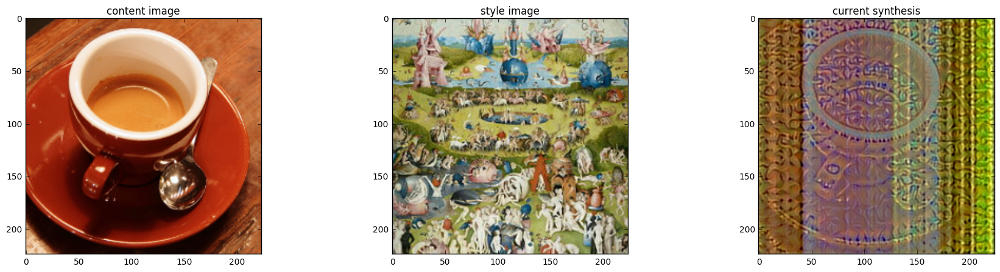

86: 15.256391525268555, -0.8121277093887329, - 1.1612073183059692
87: 15.175167083740234, -0.8256129026412964, - 1.1632180213928223
88: 15.096922874450684, -0.8391748070716858, - 1.1649564504623413
89: 15.021421432495117, -0.8528112173080444, - 1.166445255279541
90: 14.948427200317383, -0.8665221929550171, - 1.1677360534667969


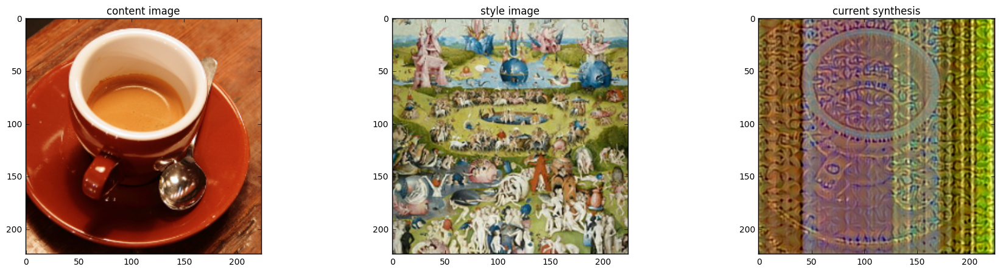

91: 14.877963066101074, -0.8803164958953857, - 1.1692262887954712
92: 14.809913635253906, -0.8942018151283264, - 1.171398639678955
93: 14.744094848632812, -0.9081785082817078, - 1.1733323335647583
94: 14.68045425415039, -0.9222518801689148, - 1.175045132637024
95: 14.619026184082031, -0.9364231824874878, - 1.1765707731246948


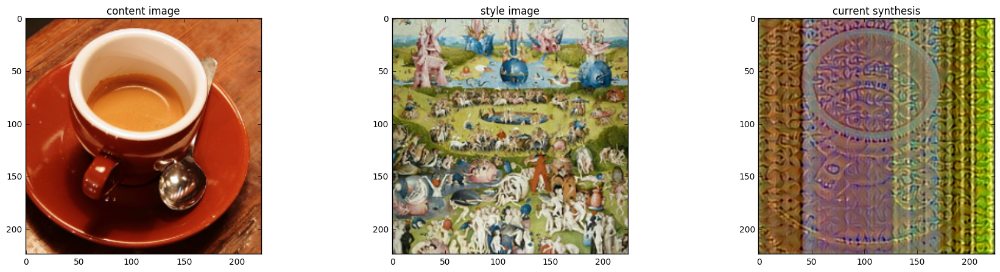

96: 14.559635162353516, -0.9506884813308716, - 1.1798393726348877
97: 14.502180099487305, -0.9650481939315796, - 1.184054970741272
98: 14.446531295776367, -0.9794973134994507, - 1.1875840425491333
99: 14.39245319366455, -0.9940287470817566, - 1.1904785633087158


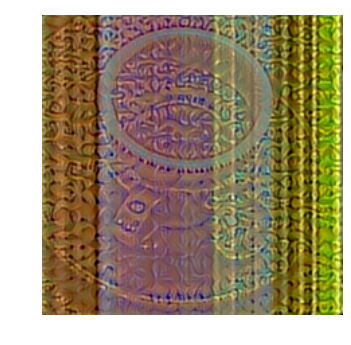

In [168]:
with tf.Session(graph=g) as sess:
    sess.run(tf.global_variables_initializer())
    
    n_iterations = 100
    og_img = net_input.eval()
    imgs = []
    for it_i in range(n_iterations):
        _, this_loss, synth = sess.run([optimizer, loss, net_input], 
                    feed_dict={
                        'vgg/dropout_1/random_uniform:0':
                            np.ones(g.get_tensor_by_name('vgg/dropout_1/random_uniform:0').get_shape().as_list()),
                        'vgg/dropout/random_uniform:0':
                            np.ones(g.get_tensor_by_name(
                            'vgg/dropout/random_uniform:0').get_shape().as_list())})
        print("{}: {}, {}, - {}".format(it_i, this_loss, np.min(synth), np.max(synth)))
        if it_i % 5 == 0:
            imgs.append(np.clip(synth[0], 0, 1))
            fig, ax = plt.subplots(1, 3, figsize = (22, 5))
            ax[0].imshow(vgg16.deprocess(img))
            ax[0].set_title('content image')
            ax[1].imshow(vgg16.deprocess(style_img))
            ax[1].set_title('style image')
            ax[2].imshow(vgg16.deprocess(synth[0]))
            ax[2].set_title('current synthesis')
            plt.show()
            fig.canvas.draw()
    gif.build_gif(imgs, saveto='stylenet_bosch_2.gif')

In [169]:
ipyd.Image(url = 'stylenet_bosch_2.gif', height=300, width=300)